# Lung cancer CXR classification
- Fastai
- ResNet50
- Resolution: 512x512
- lr finder

## Libraries

In [1]:
from fastai.vision.all import *
from PIL import Image, ImageOps
from fastai.vision.widgets import *

In [2]:
!nvidia-smi

Tue Aug 22 10:51:44 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 530.30.02              Driver Version: 530.30.02    CUDA Version: 12.1     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                  Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf            Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 2080 Ti      On | 00000000:3D:00.0 Off |                  N/A |
| 32%   30C    P8               25W / 250W|      8MiB / 11264MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
torch.cuda.set_device(2)

## Dataset

In [4]:
stats = ([0.56, 0.56, 0.56],[0.27, 0.27, 0.27])
#imagenet_stats = ([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])

In [5]:
def HImageBlock():  # For DataBlock
    return TransformBlock(type_tfms=PILImage.create, item_tfms=[Resize(512)],
                          batch_tfms=[IntToFloatTensor, *aug_transforms(do_flip=False, size=512), 
                                      Normalize.from_stats(*stats)])

In [6]:
dblock = DataBlock(blocks=(HImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=GrandparentSplitter(valid_name='val'),
                   get_y=parent_label)

In [7]:
training = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/')

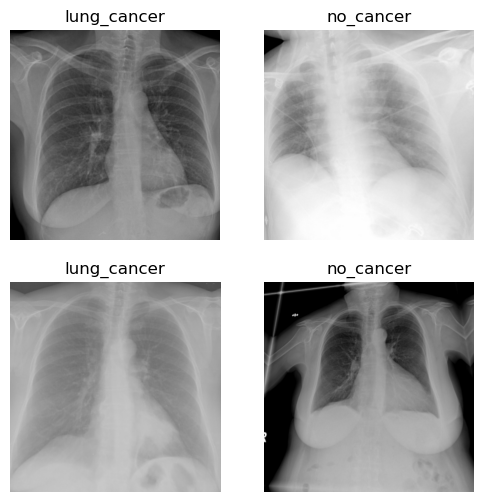

In [8]:
dls = dblock.dataloaders(training, bs=16, num_workers=4)
dls.show_batch(max_n=4)

In [9]:
dls.valid.vocab

['lung_cancer', 'no_cancer']

In [10]:
x,y = dls.one_batch()
x.mean(dim=[0,2,3]),x.std(dim=[0,2,3])

(TensorImage([0.2464, 0.2464, 0.2464], device='cuda:2'),
 TensorImage([0.7746, 0.7746, 0.7746], device='cuda:2'))

### weighted loss

In [11]:
from collections import Counter
#FROM HERE: https://forums.fast.ai/t/oversampling-in-fastai2/73721/11?u=joan
#Get weights based on the class distribution in the training data
def get_weights(dls):
   
    # 0th index would provide the vocab from text
    # 1st index would provide the vocab from classes
    classes = dls.vocab

    #Get label ids from the dataset using map
    #train_lb_ids = L(map(lambda x: x[1], dls.train_ds))
    # Get the actual labels from the label_ids & the vocab
    #train_lbls = L(map(lambda x: classes[x], train_lb_ids))

    #Combine the above into a single
    train_lbls = L(map(lambda x: classes[x[1]], dls.train_ds))
    label_counter = Counter(train_lbls)
    n_most_common_class = max(label_counter.values()); 
    print(f'Occurrences of the most common class {n_most_common_class}')
    
    # Source: https://discuss.pytorch.org/t/what-is-the-weight-values-mean-in-torch-nn-crossentropyloss/11455/9
    weights = [n_most_common_class/v for k, v in label_counter.items() if v > 0]; return weights 

In [12]:
#weights = get_weights(dls)

In [13]:
#weights

In [14]:
#myorder = [1, 0] 
#ord_weights = [weights[i] for i in myorder]
#ord_weights

In [15]:
ord_weights = [1.255621844882974, 1.0]

## Training

In [16]:
learn = vision_learner(dls, resnet50, metrics=[accuracy, RocAucBinary()], pretrained=True).to_fp16()

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [17]:
learn.loss_func

FlattenedLoss of CrossEntropyLoss()

In [18]:
learn.opt_func

<function fastai.optimizer.Adam(params: 'Tensor | Iterable', lr: 'float | slice', mom: 'float' = 0.9, sqr_mom: 'float' = 0.99, eps: 'float' = 1e-05, wd: 'Real' = 0.01, decouple_wd: 'bool' = True) -> 'Optimizer'>

In [19]:
class_weights = torch.FloatTensor(ord_weights).to(dls.device)
learn.loss_func = CrossEntropyLossFlat(weight=class_weights)

In [20]:
learn.lr

0.001

https://medium.com/@bijil.subhash/transfer-learning-how-to-pick-the-optimal-learning-rate-c8621b89c036

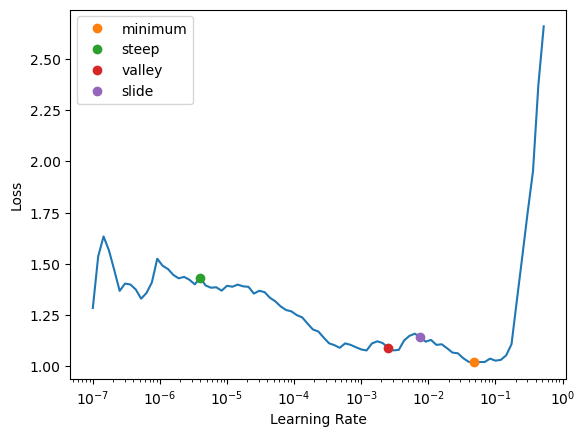

In [21]:
lrs = learn.lr_find(suggest_funcs=(minimum, steep, valley, slide))

In [22]:
learn.fit_one_cycle(5,lrs.valley)

epoch,train_loss,valid_loss,accuracy,roc_auc_score,time
0,0.449507,0.338310,0.854575,0.980915,06:15
1,0.318834,0.224282,0.885621,0.985020,05:54
2,0.225143,0.203566,0.905229,0.975725,05:46
3,0.196621,0.110576,0.952614,0.990352,05:16
4,0.175813,0.116782,0.952614,0.989923,05:22


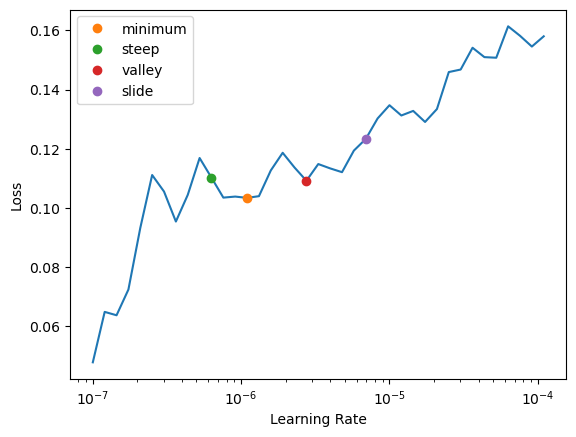

In [23]:
learn.unfreeze()
lrs = learn.lr_find(suggest_funcs=(minimum, steep, valley, slide))

epoch,train_loss,valid_loss,accuracy,roc_auc_score,time
0,0.141864,0.119182,0.952614,0.989354,05:56
1,0.154788,0.120473,0.949346,0.989348,06:43
2,0.142161,0.120570,0.949346,0.989251,05:20
3,0.160747,0.114888,0.952614,0.990270,05:27
4,0.145412,0.114246,0.954248,0.989874,05:45
5,0.136617,0.110552,0.957516,0.990628,05:52
6,0.146310,0.107612,0.955882,0.991247,05:51
7,0.156309,0.109298,0.954248,0.991209,05:55
8,0.132692,0.110280,0.955882,0.990558,05:52
9,0.144833,0.107977,0.954248,0.991089,05:52


Better model found at epoch 0 with roc_auc_score value: 0.9893537400208261.


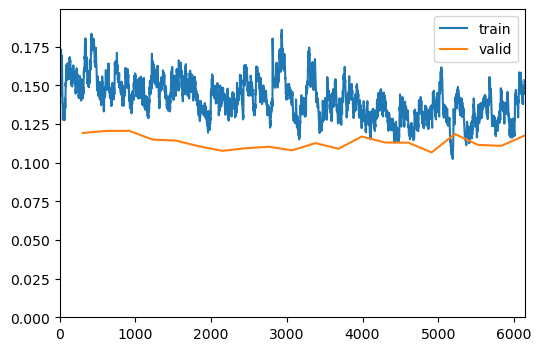

Better model found at epoch 3 with roc_auc_score value: 0.9902703054494967.
Better model found at epoch 5 with roc_auc_score value: 0.9906282540784449.
Better model found at epoch 6 with roc_auc_score value: 0.991246528982992.
Better model found at epoch 15 with roc_auc_score value: 0.9914309267615412.


In [24]:
learn.fit_one_cycle(20, slice(lrs.minimum,lrs.slide),
                   cbs=[EarlyStoppingCallback(monitor='roc_auc_score', patience=10),
                     ShowGraphCallback(),
                     SaveModelCallback(monitor='roc_auc_score', with_opt=True, 
                                       fname='fastai2_lung_cancer_resnet_V1_res512_fit_one_cycle')])

## Test

In [17]:
learn = learn.load('fastai2_lung_cancer_resnet_V1_res512_fit_one_cycle')

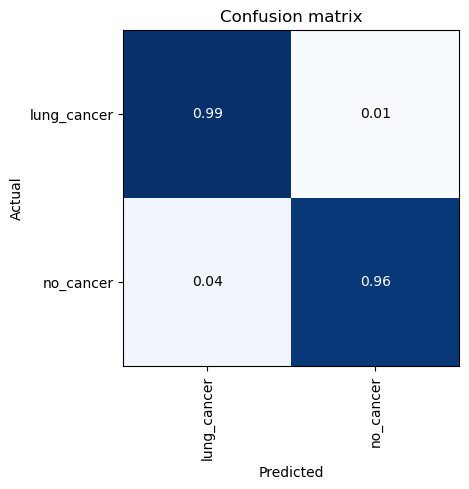

In [26]:
test_set = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test')
images_test = get_image_files(test_set)
learn.dls.loaders.append(dls.test_dl(list(images_test), with_labels=True))
interp = ClassificationInterpretation.from_learner(learn, ds_idx=2)
interp.plot_confusion_matrix(normalize=True)

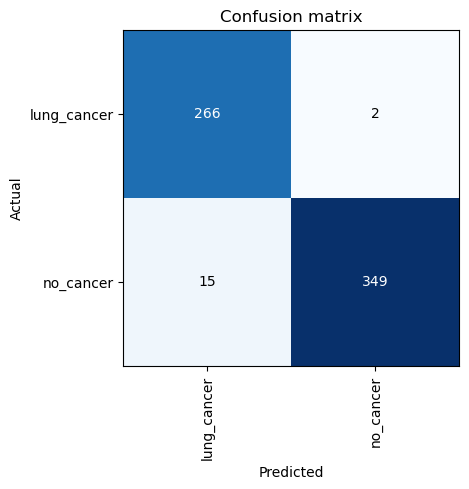

In [27]:
interp.plot_confusion_matrix(normalize=False)

In [28]:
interp.print_classification_report()

              precision    recall  f1-score   support

 lung_cancer       0.95      0.99      0.97       268
   no_cancer       0.99      0.96      0.98       364

    accuracy                           0.97       632
   macro avg       0.97      0.98      0.97       632
weighted avg       0.97      0.97      0.97       632



AUC score

In [29]:
from sklearn.metrics import roc_auc_score

# Load the test dataset
test_set = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test')
images_test = get_image_files(test_set)
test_dl = dls.test_dl(list(images_test), with_labels=True)

# Get the predictions and true labels for the test dataset
preds, targets = learn.get_preds(dl=test_dl)

# Compute the AUC score
auc_score = roc_auc_score(targets, preds[:, 1])  # Assuming binary classification, use preds[:, 1] for positive class predictions

print("AUC score:", auc_score)

AUC score: 0.9939416926357224


PR AUC

In [30]:
from sklearn.metrics import precision_recall_curve, auc

# Load the test dataset
test_set = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test')
images_test = get_image_files(test_set)
test_dl = dls.test_dl(list(images_test), with_labels=True)

# Get the predictions and true labels for the test dataset
preds, targets = learn.get_preds(dl=test_dl)

# Compute precision-recall curve
precision, recall, _ = precision_recall_curve(targets, preds[:, 1])  # Assuming binary classification, use preds[:, 1] for positive class predictions

# Compute PR AUC
pr_auc = auc(recall, precision)

print("Precision-Recall AUC:", pr_auc)

Precision-Recall AUC: 0.9961956618717666


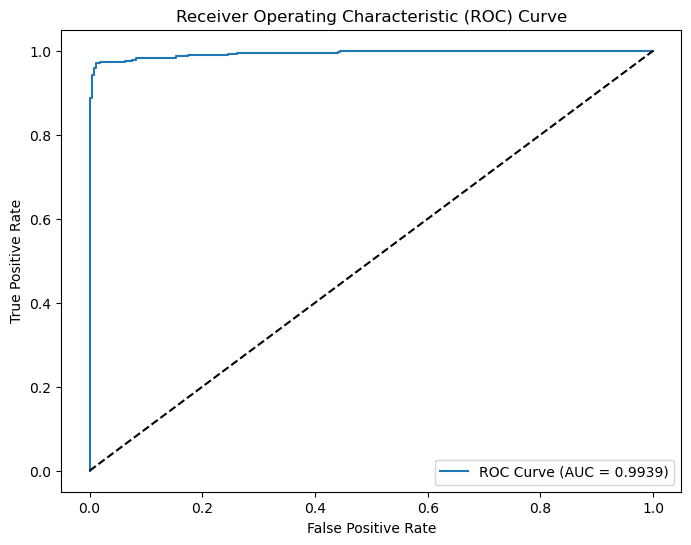

In [31]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve

# Compute the false positive rate, true positive rate, and thresholds
fpr, tpr, thresholds = roc_curve(targets, preds[:, 1])  # Assuming binary classification, use preds[:, 1] for positive class predictions

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = {:.4f})'.format(auc_score))
plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line representing random guessing
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

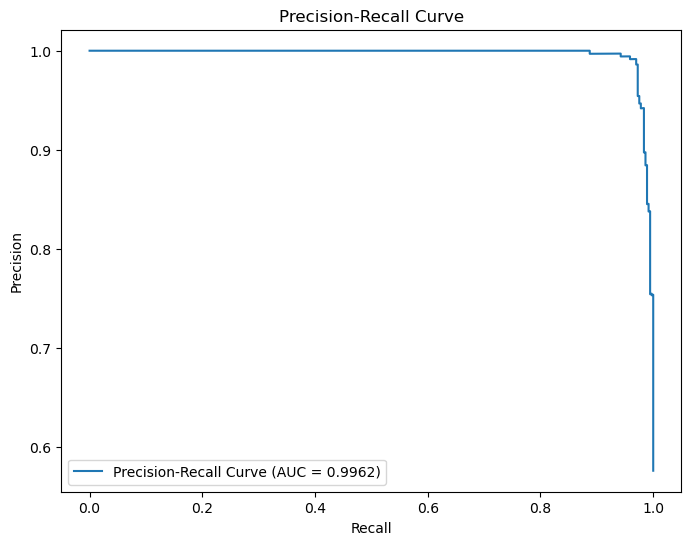

In [32]:
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve

# Compute precision-recall curve
precision, recall, thresholds = precision_recall_curve(targets, preds[:, 1])  # Assuming binary classification, use preds[:, 1] for positive class predictions

# Plot the precision-recall curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, label='Precision-Recall Curve (AUC = {:.4f})'.format(pr_auc))
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.show()

### Top losses

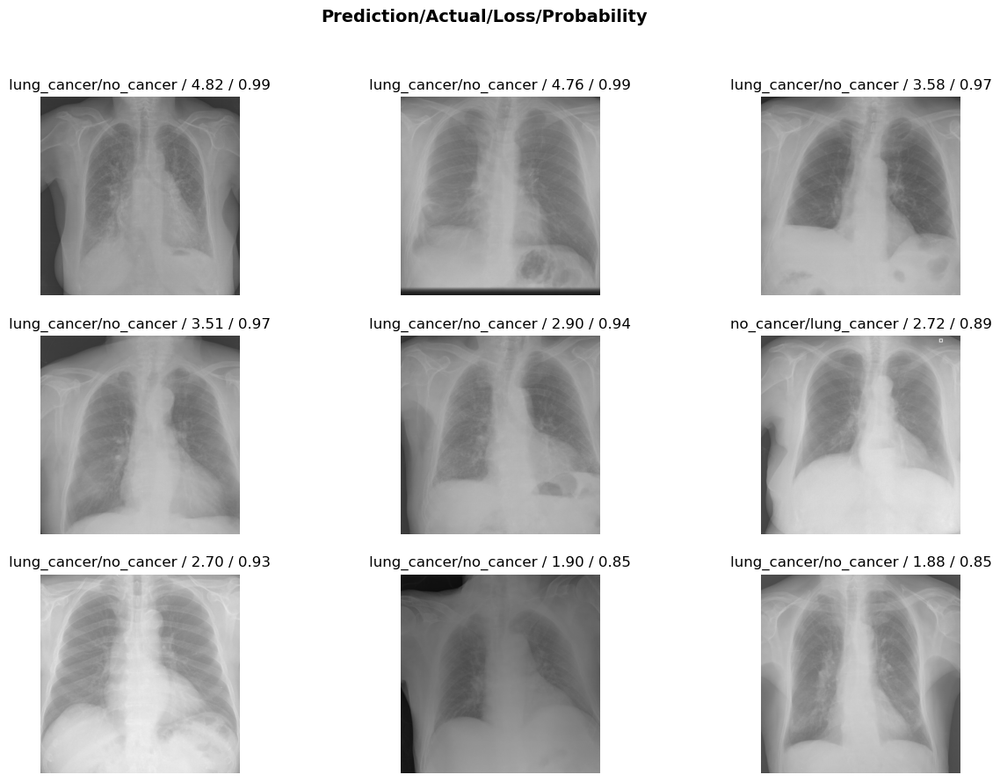

In [33]:
interp.plot_top_losses(9, figsize=(15,10))

In [34]:
# Get the top loss images and their indexes
losses, indexes = interp.top_losses(9)

# Access the underlying dataloader
dataloader = interp.dl

# Get the dataset associated with the dataloader
dataset = dataloader.dataset

# Retrieve the image paths or names using the dataset
image_paths = [dataset.items[i] for i in indexes]

# Print the image paths or names
print(image_paths)

[Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/7771_CR.1.3.51.0.7.3896945848.37088.4686.41603.16465.36597.867.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/1529472_CR.1.3.51.0.7.157045018.35695.25674.37739.55492.40373.47127.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/535913_CR.1.3.51.0.7.28657707.59101.49225.43909.55929.2874.60016.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/65224_CR.1.3.51.0.7.11407644128.35140.20033.48869.15752.58891.22748.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/14926_CR.1.3.51.0.7.12989052956.47190.49994.42791.41229.23430.22319.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/94362_CR.1.3.51.0.7.14130257803.42652.45636.38951.22749.11815.13775.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/10845_CR.1.3.51.0.7.11208137848.35523.24132.36170.14043.15470.13853.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_

In [19]:
from fastai_amalgam.interpret.all import *

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

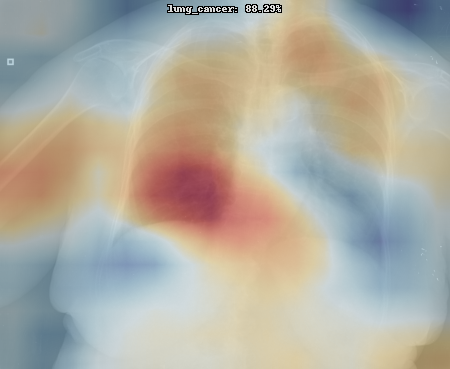

In [36]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/1541834_CR.1.3.51.0.7.2747595102.42391.22860.47098.7392.20990.50508.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

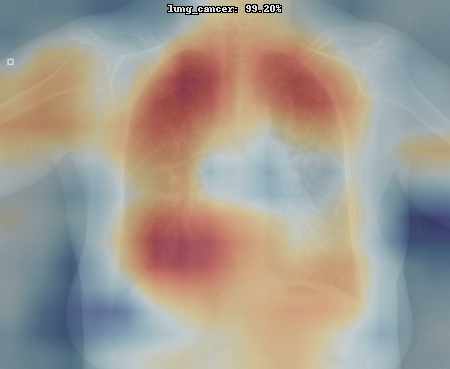

In [37]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/7771_CR.1.3.51.0.7.3896945848.37088.4686.41603.16465.36597.867.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

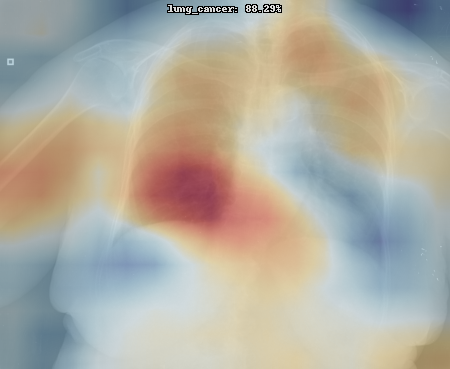

In [38]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/1541834_CR.1.3.51.0.7.2747595102.42391.22860.47098.7392.20990.50508.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

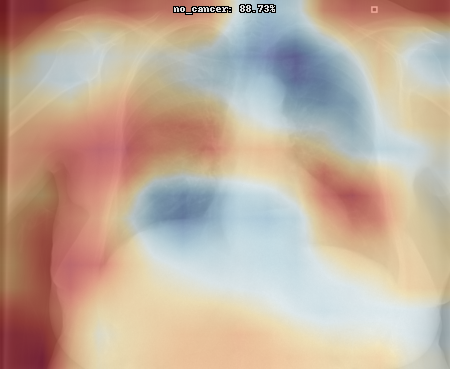

In [20]:

learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/94362_CR.1.3.51.0.7.14130257803.42652.45636.38951.22749.11815.13775.jpeg')

good predictions

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

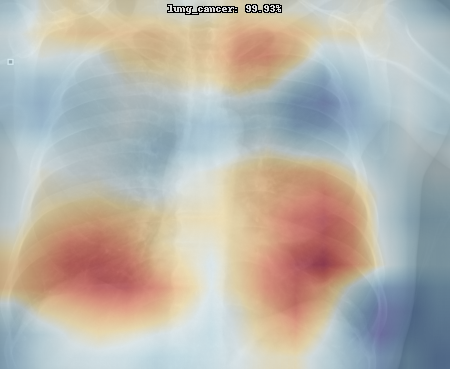

In [39]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/95160_CR.1.3.51.0.7.320254754.22501.64321.33764.31146.62878.46338.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

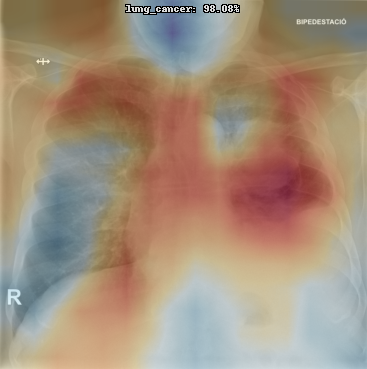

In [40]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/183542_CR.1.3.12.2.1107.5.3.49.27903.11.202102170105030355.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

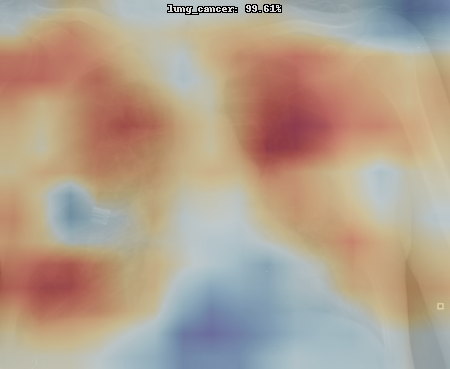

In [41]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/245243_CR.1.3.51.0.7.12230038840.49170.25160.34006.41905.25446.39009.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

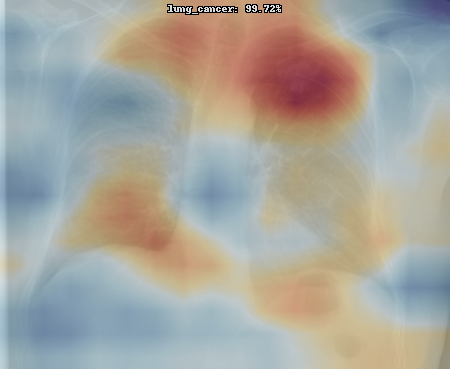

In [42]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/1546394_CR.1.3.51.0.7.14237239305.20709.17168.43206.27633.22047.25490.jpeg')

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

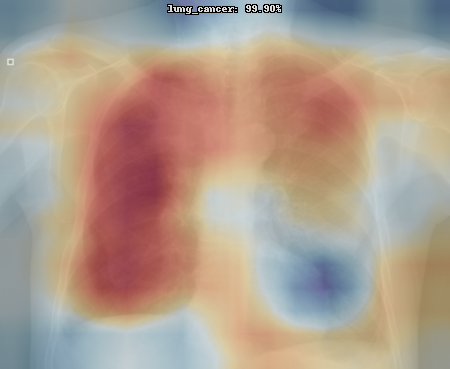

In [43]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/94870_CR.1.3.51.0.7.460929188.15158.1098.39926.48774.43723.8578.jpeg')

#### Individual preds

In [95]:
img_path = '/data/home/xmonzonis/lung_CXR/test_extern/lung_cancer/Lung_Cancer_on_Chest_X-Ray.jpg'
img = PILImage.create(img_path).resize((512, 512))
pred_class, pred_idx, outputs = learn.predict(img_path)
pred_class, pred_idx, outputs

('lung_cancer', tensor(0), tensor([9.9999e-01, 9.7419e-06]))

In [99]:
img_path = '/mnt/purepaas/Joan/DICOM/COVID_MAR_V6/Images/Pneumonia/32008_CR.1.3.51.0.7.14041143698.1469.40265.34333.35558.7704.58729.jpeg'
img = PILImage.create(img_path).resize((512, 512))
pred_class, pred_idx, outputs = learn.predict(img_path)
pred_class, pred_idx, outputs

('no_cancer', tensor(1), tensor([7.4846e-05, 9.9993e-01]))

In [102]:
img_path = '/mnt/purepaas/Joan/DICOM/COVID_MAR_V6/Images/COVID/71456_CR.1.3.51.0.7.84200429.49509.51790.35108.13280.37321.14139.jpeg'
img = PILImage.create(img_path).resize((512, 512))
pred_class, pred_idx, outputs = learn.predict(img_path)
pred_class, pred_idx, outputs

('no_cancer', tensor(1), tensor([2.3181e-07, 1.0000e+00]))

--------------

## Fastai model with defaults

In [106]:
learn = vision_learner(dls, resnet50, metrics=[accuracy, RocAucBinary()], pretrained=True).to_fp16()

epoch,train_loss,valid_loss,accuracy,roc_auc_score,time
0,0.510331,0.242383,0.905199,0.970884,03:01
1,0.417861,0.196295,0.922018,0.977834,03:13
2,0.335603,0.168550,0.941896,0.983465,03:20
3,0.311392,0.218821,0.911315,0.970193,03:05
4,0.273244,0.154102,0.931193,0.987482,03:09


Better model found at epoch 0 with roc_auc_score value: 0.9708839223571263.


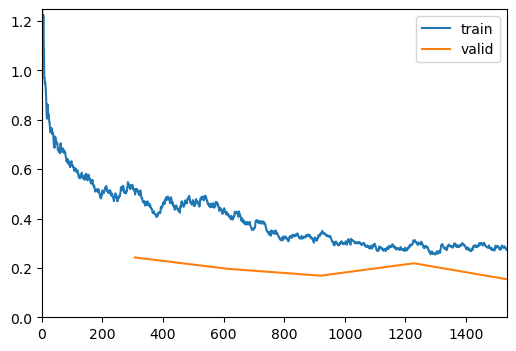

Better model found at epoch 1 with roc_auc_score value: 0.9778342742247312.
Better model found at epoch 2 with roc_auc_score value: 0.9834651225736601.
Better model found at epoch 4 with roc_auc_score value: 0.9874816332843553.


epoch,train_loss,valid_loss,accuracy,roc_auc_score,time
0,0.239331,0.143941,0.946483,0.991435,03:40
1,0.209415,0.129005,0.949541,0.992779,03:30
2,0.190698,0.166596,0.940367,0.982160,03:28
3,0.200409,0.120353,0.951070,0.990343,03:43
4,0.197334,0.093222,0.967890,0.993978,03:38
5,0.204116,0.186528,0.922018,0.978796,03:25
6,0.142797,0.121444,0.946483,0.991319,03:46
7,0.174469,0.215397,0.908257,0.982861,03:08
8,0.139733,0.117693,0.958716,0.992431,03:00
9,0.133244,0.123067,0.955657,0.990638,03:28


Better model found at epoch 0 with roc_auc_score value: 0.9914353104941612.


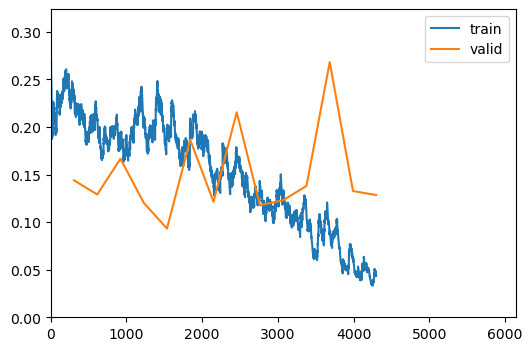

Better model found at epoch 1 with roc_auc_score value: 0.9927789807439485.
Better model found at epoch 4 with roc_auc_score value: 0.9939776506070683.
No improvement since epoch 4: early stopping


In [107]:
learn.fine_tune(20, freeze_epochs=5,
                cbs=[EarlyStoppingCallback(monitor='roc_auc_score', patience=10),
                     ShowGraphCallback(),
                     SaveModelCallback(monitor='roc_auc_score', with_opt=True, 
                                       fname='fastai2_lung_cancer_resnet_V1_res512')])

In [108]:
learn = learn.load('fastai2_lung_cancer_resnet_V1_res512')

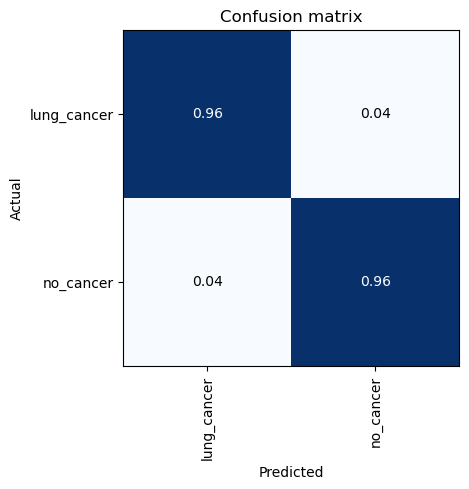

In [116]:
test_set = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test')
images_test = get_image_files(test_set)
learn.dls.loaders.append(dls.test_dl(list(images_test), with_labels=True))
interp = ClassificationInterpretation.from_learner(learn, ds_idx=2)
interp.plot_confusion_matrix(normalize=True)

In [117]:
interp.print_classification_report()

              precision    recall  f1-score   support

 lung_cancer       0.95      0.96      0.96       268
   no_cancer       0.97      0.96      0.96       322

    accuracy                           0.96       590
   macro avg       0.96      0.96      0.96       590
weighted avg       0.96      0.96      0.96       590



In [ ]:
len(dls.dsets)

In [ ]:
dls.dsets[2]

In [40]:
test_set2 = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test')
images_test2 = get_image_files(test_set2)
test_dl = dls.test_dl(list(images_test2), with_labels=False)
predictions, _ = learn.get_preds(dl=test_dl)

In [42]:
predictions
predictions.argmax(dim=1)

tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
        1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [45]:
file_predictions = []
for i in range(len(images_test2)):
    file = images_test2[i]
    prediction = predictions[i]
    file_predictions.append((file, prediction))
file_predictions

[(Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/1536193_CR.1.3.51.0.7.1818658736.38918.8004.36286.61112.53167.23132.jpeg'),
  tensor([0.0100, 0.9900])),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/774785_CR.1.3.51.0.7.1631968429.39554.17395.48249.58860.48810.1811.jpeg'),
  tensor([3.3699e-05, 9.9997e-01])),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/245243_CR.1.3.51.0.7.1665221599.26664.1869.46618.35230.36929.17447.jpeg'),
  tensor([0.4837, 0.5163])),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/731946_CR.1.3.12.2.1107.5.3.49.27903.11.202112301311220278.jpeg'),
  tensor([1.0667e-04, 9.9989e-01])),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/736545_CR.1.3.51.0.7.13520395696.63313.19617.45878.18950.12292.26155.jpeg'),
  tensor([4.6710e-06, 1.0000e+00])),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/195862_CR.1.3.51.0.7.3738641968.9968.19976.46747.41302.24186.57861.jpeg'),
  

In [46]:
file_predictions_labels = []
for i in range(len(images_test2)):
    file = images_test2[i]
    prediction = predictions[i]
    label = learn.dls.vocab[prediction.argmax()]
    file_predictions_labels.append((file, prediction, label))
file_predictions_labels

[(Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/1536193_CR.1.3.51.0.7.1818658736.38918.8004.36286.61112.53167.23132.jpeg'),
  tensor([0.0100, 0.9900]),
  'lung_cancer'),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/774785_CR.1.3.51.0.7.1631968429.39554.17395.48249.58860.48810.1811.jpeg'),
  tensor([3.3699e-05, 9.9997e-01]),
  'lung_cancer'),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/245243_CR.1.3.51.0.7.1665221599.26664.1869.46618.35230.36929.17447.jpeg'),
  tensor([0.4837, 0.5163]),
  'lung_cancer'),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/731946_CR.1.3.12.2.1107.5.3.49.27903.11.202112301311220278.jpeg'),
  tensor([1.0667e-04, 9.9989e-01]),
  'lung_cancer'),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung_cancer/736545_CR.1.3.51.0.7.13520395696.63313.19617.45878.18950.12292.26155.jpeg'),
  tensor([4.6710e-06, 1.0000e+00]),
  'lung_cancer'),
 (Path('/data/home/xmonzonis/lung_CXR/LungX_V0/test/lung

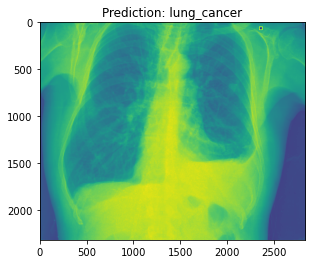

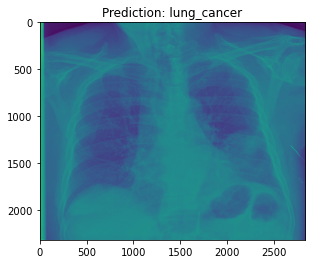

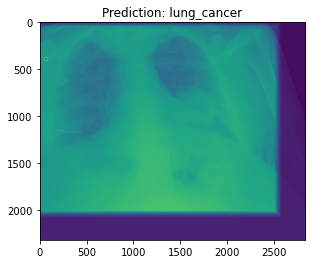

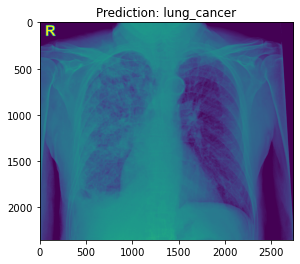

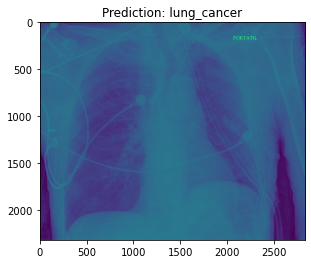

...

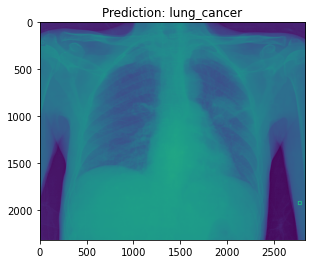

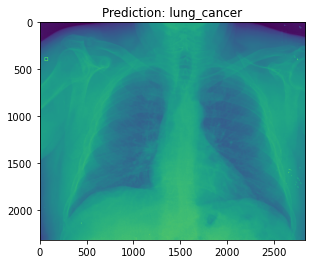

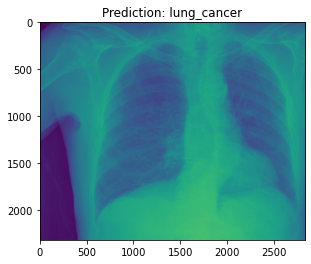

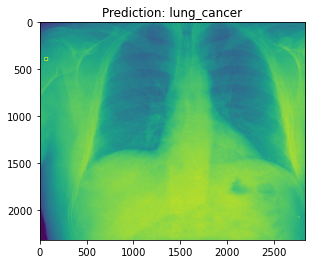

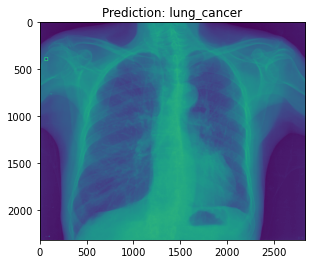

In [47]:
import matplotlib.pyplot as plt

# Select images labeled as "lung_cancer"
lung_cancer_images = [(file, prediction, label) for file, prediction, label in file_predictions_labels if label == "lung_cancer"]

# Display the selected images
for file, prediction, label in lung_cancer_images:
    img = plt.imread(file)
    plt.imshow(img)
    plt.title(f"Prediction: {label}")
    plt.show()

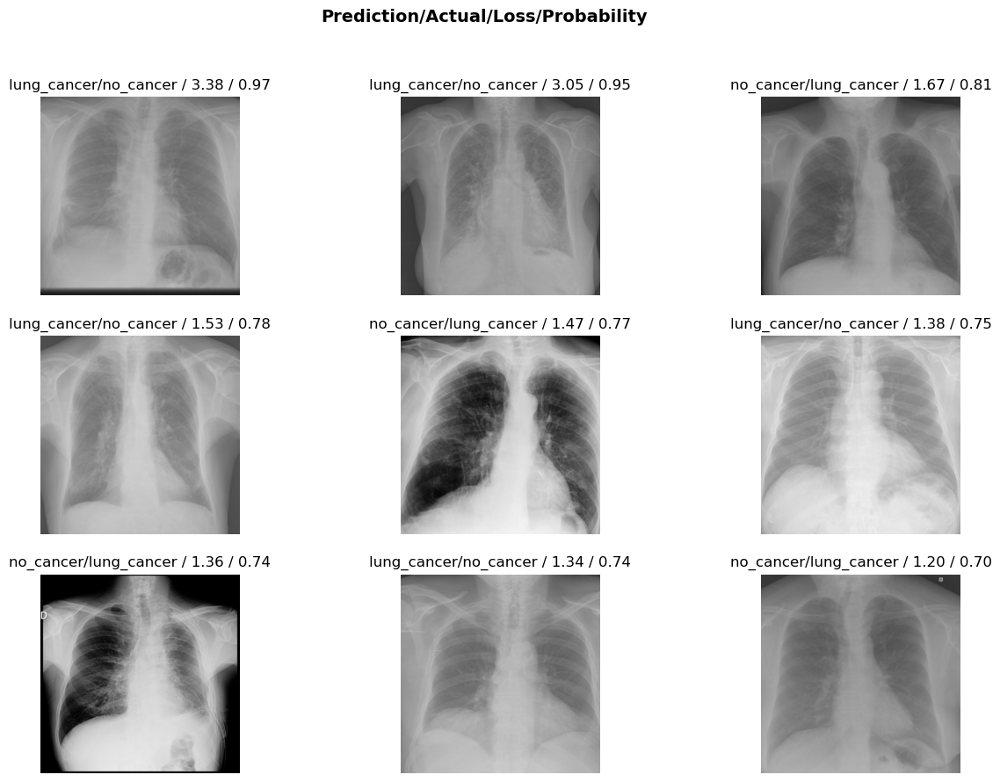

In [127]:
interp.plot_top_losses(9, figsize=(15,10))

In [128]:
# Get the top loss images and their indexes
losses, indexes = interp.top_losses(9)

# Access the underlying dataloader
dataloader = interp.dl

# Get the dataset associated with the dataloader
dataset = dataloader.dataset

# Retrieve the image paths or names using the dataset
image_paths = [dataset.items[i] for i in indexes]

# Print the image paths or names
print(image_paths)


[Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/1529472_CR.1.3.51.0.7.157045018.35695.25674.37739.55492.40373.47127.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/7771_CR.1.3.51.0.7.3896945848.37088.4686.41603.16465.36597.867.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/1031244_CR.1.3.51.0.7.13512534350.59090.24399.46483.62556.49137.47017.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/1531676_CR.1.3.51.0.7.11566714543.38599.29250.36119.55318.13739.53576.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/196862_CR.1.3.51.0.7.11442196202.54400.60228.43249.37926.56842.48269.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/10845_CR.1.3.51.0.7.11208137848.35523.24132.36170.14043.15470.13853.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test/lung_cancer/256358_CR.1.2.392.200036.9116.1.1.1.1.11668720.20171212140110.jpeg'), Path('/data/home/xmonzonis/lung_CXR/LungX_V1/te

/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/interpret/gradcam.py:65: UserWarning: Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened
  warnings.warn(f"Detected a pooling layer in the model body. Unless this is intentional, ensure that the feature map is not flattened")
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/data/home/xmonzonis/.conda/envs/PyTorch_fastai_timm/lib/python3.8/site-packages/fastai_amalgam/utils.py:92: UserWarning: Loaded default

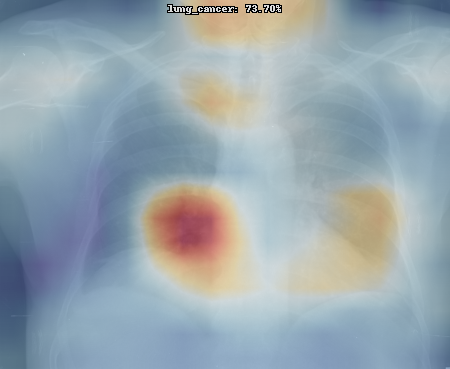

In [129]:
learn.gradcam('/data/home/xmonzonis/lung_CXR/LungX_V1/test/no_cancer/17230_CR.1.3.51.0.7.96449292.19140.28225.47333.29940.8166.3495.jpeg')

In [130]:
from sklearn.metrics import roc_auc_score

# Load the test dataset
test_set = Path('/data/home/xmonzonis/lung_CXR/LungX_V1/test')
images_test = get_image_files(test_set)
test_dl = dls.test_dl(list(images_test), with_labels=True)

# Get the predictions and true labels for the test dataset
preds, targets = learn.get_preds(dl=test_dl)

# Compute the AUC score
auc_score = roc_auc_score(targets, preds[:, 1])  # Assuming binary classification, use preds[:, 1] for positive class predictions

print("AUC Score:", auc_score)

AUC Score: 0.9936613516269583


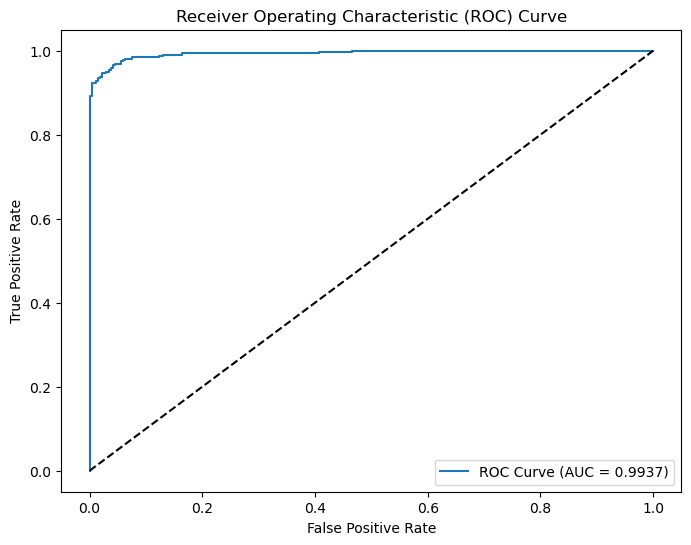

In [131]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve

# Compute the false positive rate, true positive rate, and thresholds
fpr, tpr, thresholds = roc_curve(targets, preds[:, 1])  # Assuming binary classification, use preds[:, 1] for positive class predictions

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = {:.4f})'.format(auc_score))
plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line representing random guessing
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()